# Notebook reading VisiumHD Dataset of Mouse Lung using bin2cell
[Bin2Cell Tutorial](https://nbviewer.org/github/Teichlab/bin2cell/blob/main/notebooks/demo.ipynb)
- Dataset: https://www.10xgenomics.com/datasets/visium-hd-cytassist-gene-expression-mouse-lung-fresh-frozen
- Created by: Christian Eger
- Created on: 19th of November 2024
- Environment: bin2cell-env

Bin2cell provides solutions for both reading VisiumHD datasets and aggregating its spots to cells.

## Setup

### Control Flow

In [8]:
run_stardist_he = False
run_stardist_gex = False

### Import modules

In [9]:
from pathlib import Path
from datetime import datetime
import logging

import bin2cell as b2c
import scanpy as sc
import tensorflow as tf
import numpy as np
np.random.seed(1776)
import matplotlib.pyplot as plt

from utilities import spatial_subset


for device in tf.config.list_physical_devices():
    print(device)

PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')
PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')
PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU')


### Setup paths

In [10]:
notebook_name = "0-b2c_load_raw_data.ipynb" 
notebook_path = Path.cwd() / notebook_name
notebook_execution_time = datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
repo_path = Path.cwd().parent
data_folder_path = repo_path / ".data"
stardist_path = data_folder_path / "stardist"
stardist_path.mkdir(exist_ok=True)

spatial_data_path = data_folder_path / "raw" / "VisiumHD_Mouse_Lung" / "binned_outputs" / "square_002um"
adata_path = data_folder_path / "processed" / "preprocessing" / "2024-11-05_19-08-36_VisiumHD_mouse_lung_square_002um.h5ad"


### Load and preprocess data

In [11]:
# Reading Data
adata = b2c.read_visium(spatial_data_path, source_image_path=data_folder_path / "raw" / "VisiumHD_Mouse_Lung" / "Visium_HD_Mouse_Lung_Fresh_Frozen_tissue_image.tif")
adata.var_names_make_unique()
# Filtering Data
sc.pp.filter_genes(adata, min_cells=3)
sc.pp.filter_cells(adata, min_counts=1)
adata_bin2cell = adata.copy()

adata_bin2cell

anndata.py (1756): Variable names are not unique. To make them unique, call `.var_names_make_unique`.
anndata.py (1756): Variable names are not unique. To make them unique, call `.var_names_make_unique`.


AnnData object with n_obs × n_vars = 9117867 × 17743
    obs: 'in_tissue', 'array_row', 'array_col', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial', 'log'
    obsm: 'spatial'

## Bin2Cell

### Setting up parameters

In [12]:
mpp = 0.25
b2c.scaled_he_image(adata_bin2cell, mpp=mpp, save_path=stardist_path / f"{mpp}_he.tif")
b2c.destripe(adata_bin2cell)

_construct.py (149): Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`


### QC of image quality and alignment with GEX

anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


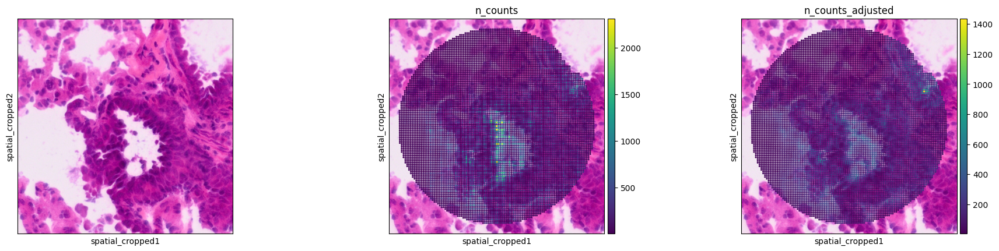

anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


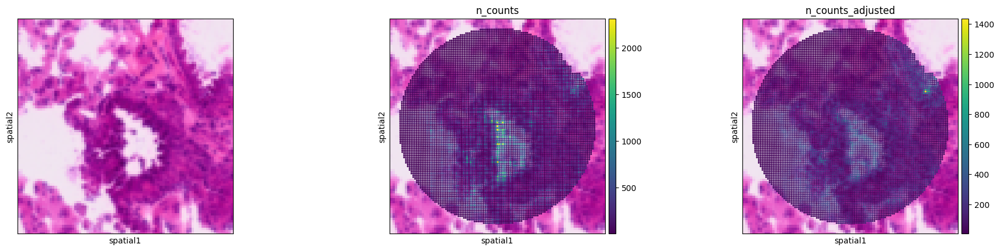

In [13]:
"""
Comparing the custom high resolution image with regular hires spaceranger image
The b2c tutorial suggests img_key="0.5_mpp_150_buffer" and basis="spatial_cropped_150_buffer", however this only worked after removing "_150_buffer"
"""
spatial_subset_params = (adata_bin2cell, ["circle"], [((11287, 35244), 400)], ["keep"])
sc.pl.spatial(spatial_subset(*spatial_subset_params), color=[None, "n_counts", "n_counts_adjusted"], img_key="0.25_mpp", basis="spatial_cropped")
sc.pl.spatial(spatial_subset(*spatial_subset_params), color=[None, "n_counts", "n_counts_adjusted"])

anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


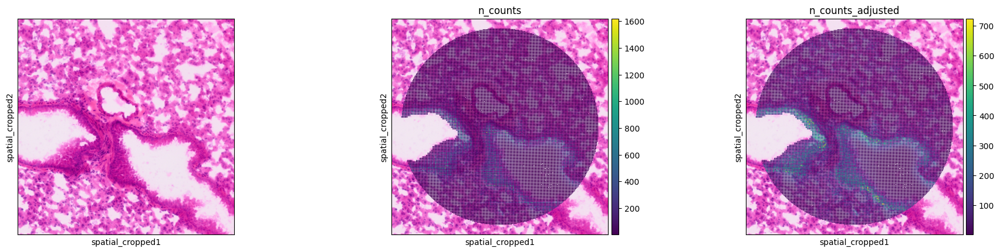

anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


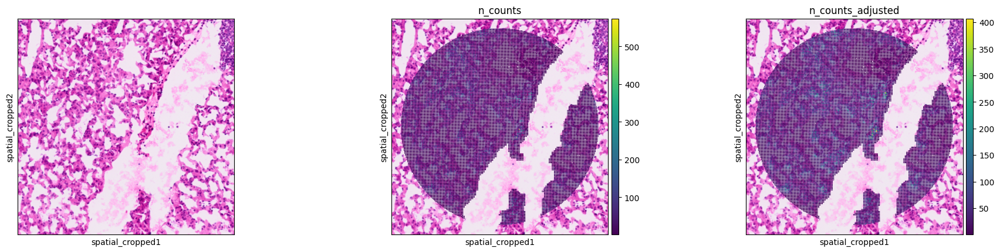

anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


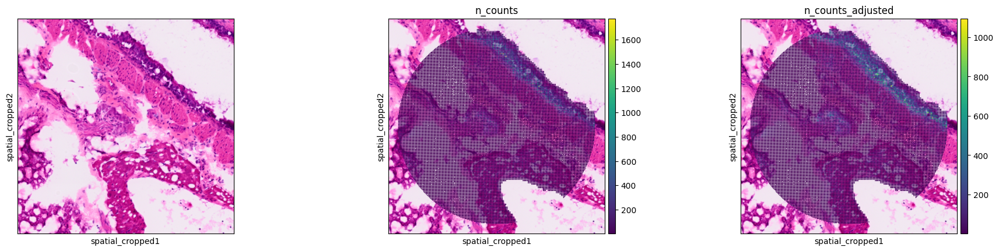

anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


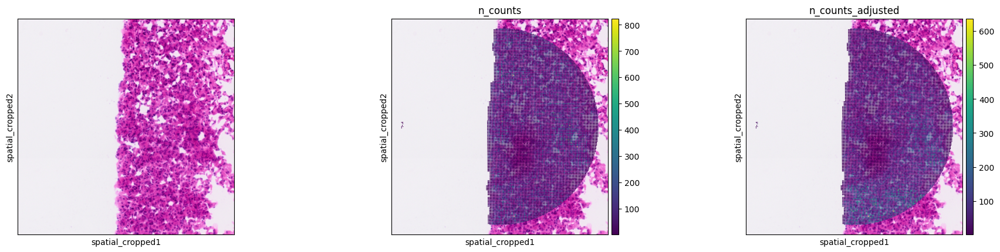

In [14]:
"""
Checking alignment of spots with microscope image on 4 random spots in the tissue
"""
spots = [tuple(row) for row in adata_bin2cell[adata_bin2cell.obs["n_counts"] >= 50].obsm["spatial"][np.random.choice(adata_bin2cell[adata_bin2cell.obs["n_counts"] >= 50].obsm["spatial"].shape[0], 4, replace=False)]]
for spot in spots:
    sc.pl.spatial(spatial_subset(adata_bin2cell, ["circle"], [(spot, 1000)], ["keep"]), color=[None, "n_counts", "n_counts_adjusted"], img_key="0.25_mpp", basis="spatial_cropped")

### Running Stardest HE model

In [15]:
if run_stardist_he:
    b2c.stardist(
        image_path=stardist_path / f"{mpp}_he.tif",
        labels_npz_path=data_folder_path / f"he_{mpp}.npz", 
        stardist_model="2D_versatile_he", 
        prob_thresh=0.01
    )

In [16]:
b2c.insert_labels(
    adata_bin2cell, 
    labels_npz_path=str(data_folder_path / f"he_{mpp}.npz"), # gotta convert to a string, otherwise the function complains
    basis="spatial", 
    spatial_key="spatial_cropped",
    mpp=mpp, 
    labels_key="labels_he"
)
adata_bin2cell

AnnData object with n_obs × n_vars = 9117867 × 17743
    obs: 'in_tissue', 'array_row', 'array_col', 'n_counts', 'destripe_factor', 'n_counts_adjusted', 'labels_he'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial', 'log', 'bin2cell'
    obsm: 'spatial', 'spatial_cropped'

In [17]:
adata_bin2cell.obs = adata_bin2cell.obs.assign(labels_he_str=lambda x: x.labels_he.astype(str))
adata_bin2cell.obs

,in_tissue,array_row,array_col,n_counts,destripe_factor,n_counts_adjusted,labels_he,labels_he_str
s_002um_00658_01498-1,1,658,1498,47.0,0.708878,187.143798,0,0
s_002um_02587_02503-1,1,2587,2503,54.0,0.077460,20.449457,0,0
s_002um_01674_00710-1,1,1674,710,25.0,0.391175,103.270254,131460,131460
s_002um_02498_02808-1,1,2498,2808,3.0,0.077944,20.577116,0,0
s_002um_00952_00136-1,1,952,136,83.0,0.408602,107.870847,211147,211147
...,...,...,...,...,...,...,...,...
s_002um_03248_02696-1,1,3248,2696,7.0,0.049358,13.030480,0,0
s_002um_00212_00415-1,1,212,415,38.0,0.473624,125.036763,0,0
s_002um_03062_00964-1,1,3062,964,17.0,0.063845,16.855117,0,0
s_002um_00504_01845-1,1,504,1845,27.0,0.188007,49.633858,0,0


anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


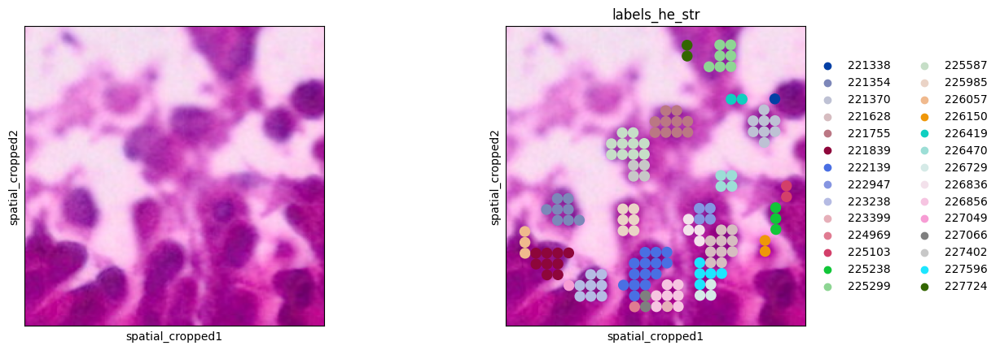

anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


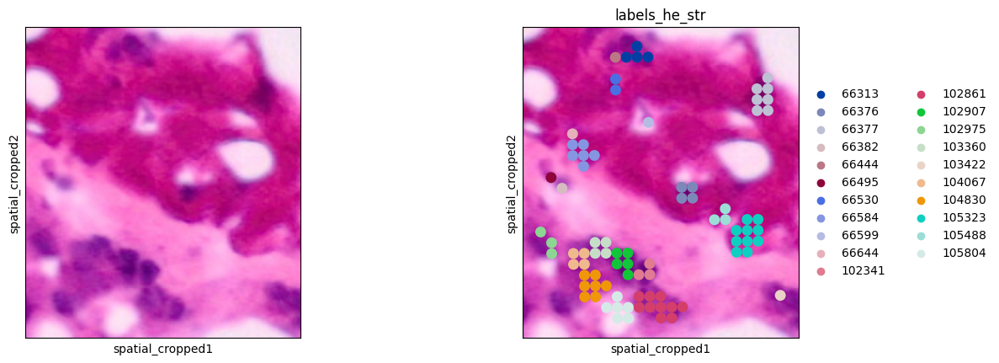

anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


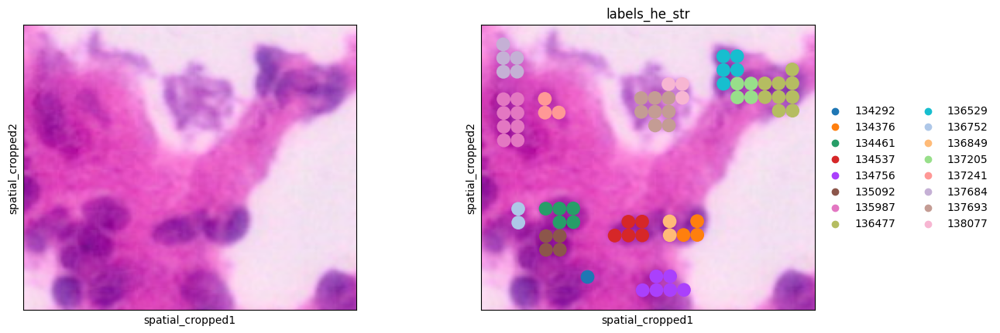

anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


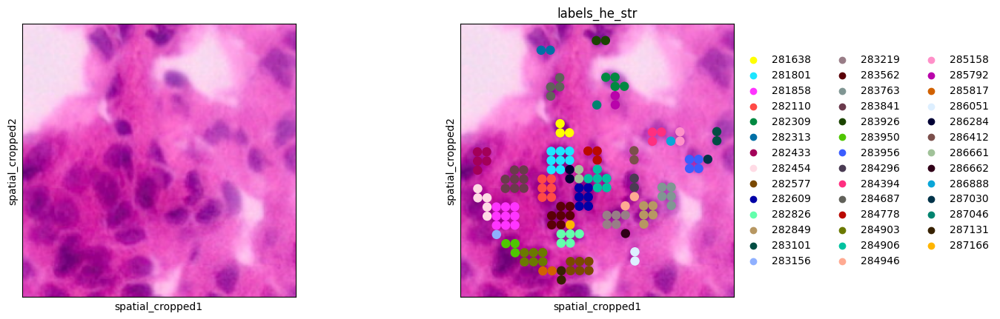

In [18]:
spots = [tuple(row) for row in adata_bin2cell[adata_bin2cell.obs["labels_he_str"] != "0"].obsm["spatial"][np.random.choice(adata_bin2cell[adata_bin2cell.obs["labels_he_str"] != "0"].shape[0], 4, replace=False)]]
for spot in spots:
    sc.pl.spatial(spatial_subset(adata_bin2cell[adata_bin2cell.obs["labels_he_str"] != "0"], ["circle"], [(spot, 100)], ["keep"]), color=[None, "labels_he_str"], img_key=f"{mpp}_mpp", basis="spatial_cropped")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.1990521401166916..1.0].
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


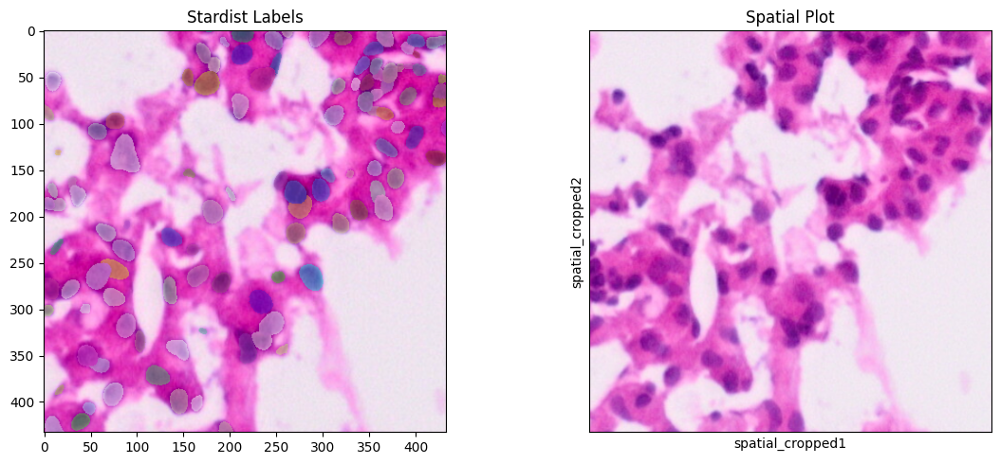

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.23188406229019165..1.0].
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


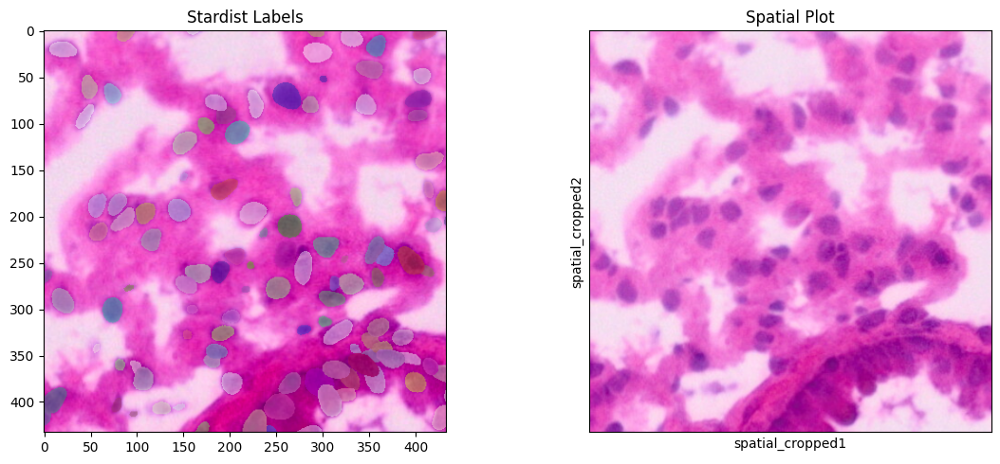

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.09913793206214905..1.0].
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


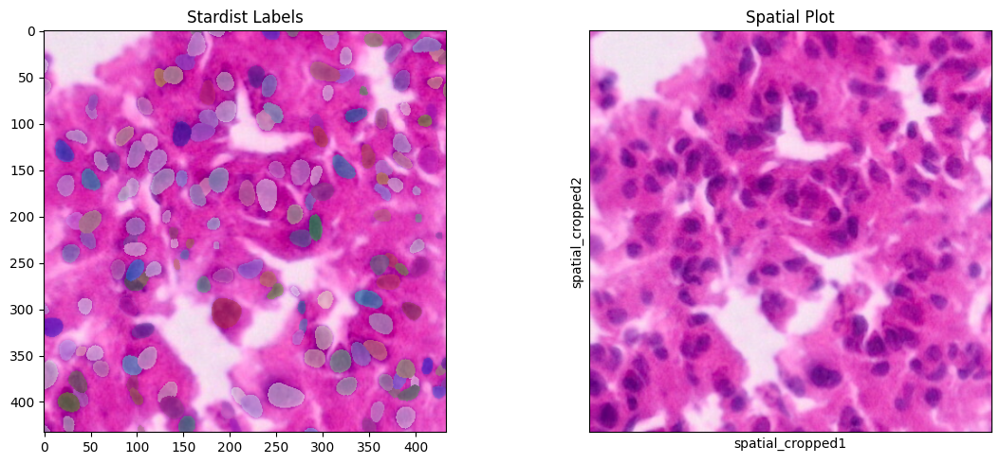

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.028340080752968788..1.0040485858917236].
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


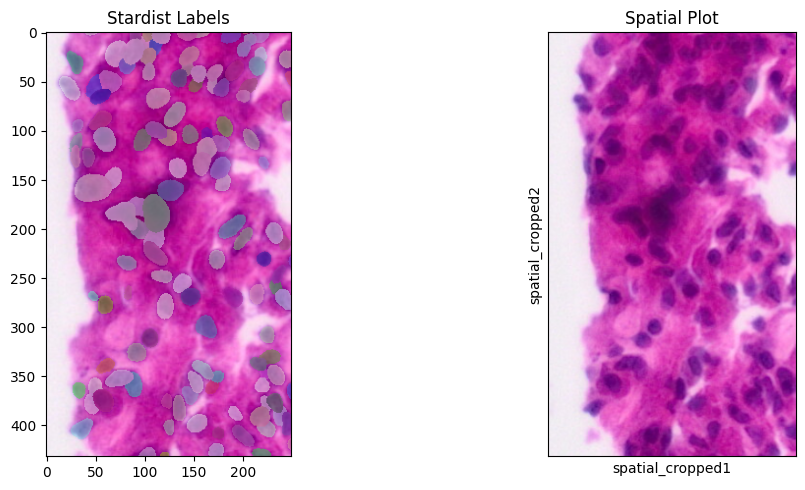

In [19]:
spots = [tuple(row) for row in adata_bin2cell[adata_bin2cell.obs["n_counts"] >= 50].obsm["spatial"][np.random.choice(adata_bin2cell[adata_bin2cell.obs["n_counts"] >= 50].obsm["spatial"].shape[0], 4, replace=False)]]
for spot in spots:
   adata_subset = spatial_subset(adata_bin2cell, ["circle"], [(spot, 200)], ["keep"])
   fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
   stardist_img = b2c.view_stardist_labels(
       image_path=stardist_path / f"{mpp}_he.tif",
       labels_npz_path=data_folder_path / f"he_{mpp}.npz", 
       crop=b2c.get_crop(adata_subset, basis="spatial", spatial_key="spatial_cropped", mpp=mpp)
   )
   ax1.imshow(stardist_img)
   ax1.set_title('Stardist Labels')
   sc.pl.spatial(adata_subset, img_key=f"{mpp}_mpp", basis="spatial_cropped", ax=ax2, show=False)
   ax2.set_title('Spatial Plot')
   plt.tight_layout()
   plt.show()

In [20]:
b2c.expand_labels(
    adata_bin2cell, 
    labels_key='labels_he', 
    expanded_labels_key="labels_he_expanded",
    max_bin_distance=2,
)

In [21]:
adata_bin2cell.obs = adata_bin2cell.obs.assign(labels_he_expanded_str=lambda x: x.labels_he_expanded.astype(str))
adata_bin2cell.obs

,in_tissue,array_row,array_col,n_counts,destripe_factor,n_counts_adjusted,labels_he,labels_he_str,labels_he_expanded,labels_he_expanded_str
s_002um_00658_01498-1,1,658,1498,47.0,0.708878,187.143798,0,0,275191,275191
s_002um_02587_02503-1,1,2587,2503,54.0,0.077460,20.449457,0,0,0,0
s_002um_01674_00710-1,1,1674,710,25.0,0.391175,103.270254,131460,131460,131460,131460
s_002um_02498_02808-1,1,2498,2808,3.0,0.077944,20.577116,0,0,0,0
s_002um_00952_00136-1,1,952,136,83.0,0.408602,107.870847,211147,211147,211147,211147
...,...,...,...,...,...,...,...,...,...,...
s_002um_03248_02696-1,1,3248,2696,7.0,0.049358,13.030480,0,0,0,0
s_002um_00212_00415-1,1,212,415,38.0,0.473624,125.036763,0,0,0,0
s_002um_03062_00964-1,1,3062,964,17.0,0.063845,16.855117,0,0,0,0
s_002um_00504_01845-1,1,504,1845,27.0,0.188007,49.633858,0,0,275397,275397


anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


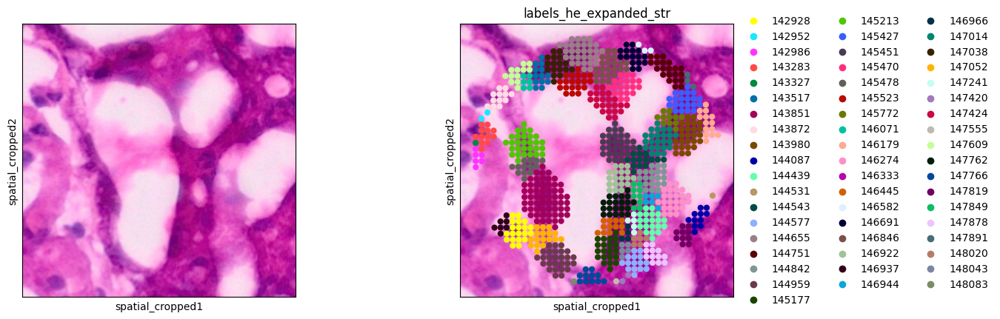

anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


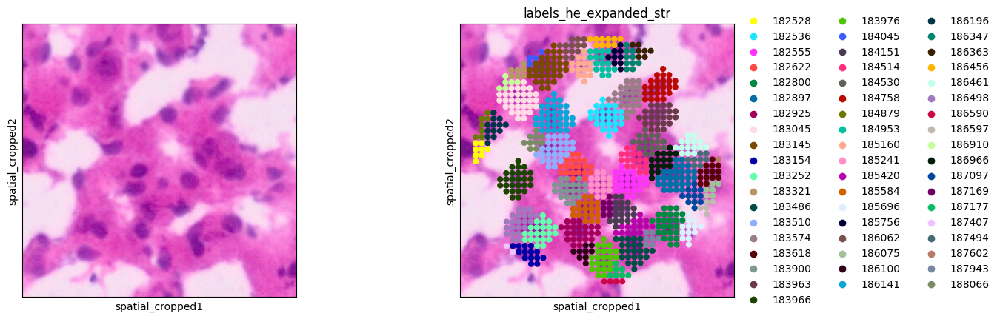

anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


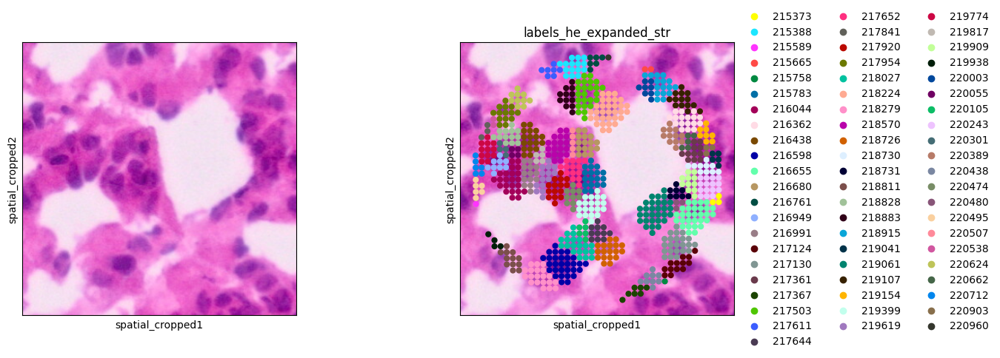

anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


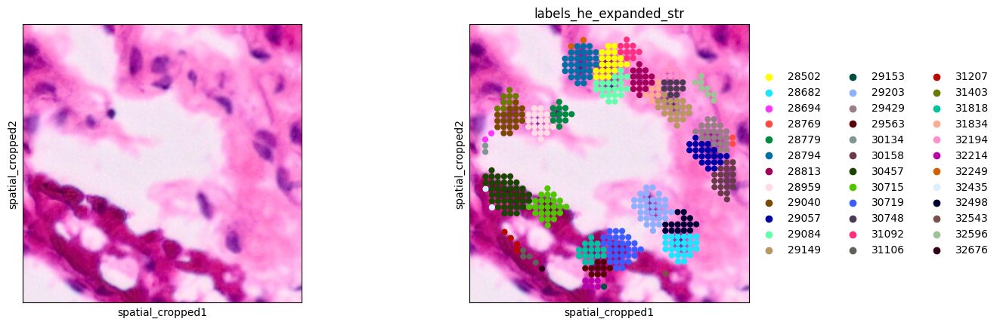

In [22]:
spots = [tuple(row) for row in adata_bin2cell.obsm["spatial"][np.random.choice(adata_bin2cell.shape[0], 4, replace=False)]]
for spot in spots:
    sc.pl.spatial(spatial_subset(adata_bin2cell[adata_bin2cell.obs["labels_he_expanded_str"] != "0"], ["circle"], [(spot, 150)], ["keep"]), color=[None, "labels_he_expanded_str"], img_key=f"{mpp}_mpp", basis="spatial_cropped")

### Running Stardist fluo model on GEX data

In [23]:
b2c.grid_image(adata_bin2cell, "n_counts_adjusted", mpp=mpp, sigma=5, save_path=stardist_path / f"{mpp}_gex.tif")

In [24]:
if run_stardist_gex:
    b2c.stardist(
        image_path=stardist_path / f"{mpp}_gex.tif", 
        labels_npz_path=stardist_path / f"{mpp}_gex.npz", 
        stardist_model="2D_versatile_fluo", 
        prob_thresh=0.05, 
        nms_thresh=0.5
    )

In [25]:
adata_bin2cell.obs.astype({"labels_he": str})["labels_he"]

s_002um_00658_01498-1         0
s_002um_02587_02503-1         0
s_002um_01674_00710-1    131460
s_002um_02498_02808-1         0
s_002um_00952_00136-1    211147
                          ...  
s_002um_03248_02696-1         0
s_002um_00212_00415-1         0
s_002um_03062_00964-1         0
s_002um_00504_01845-1         0
s_002um_03170_00732-1         0
Name: labels_he, Length: 9117867, dtype: object

In [26]:
b2c.insert_labels(adata_bin2cell, 
    labels_npz_path=str(stardist_path / f"{mpp}_gex.npz"),
    basis="array", 
    mpp=mpp, 
    labels_key="labels_gex"
)

In [27]:
adata_bin2cell.obs = adata_bin2cell.obs.assign(labels_gex_str=lambda x: x.labels_gex.astype(str))
adata_bin2cell.obs

,in_tissue,array_row,array_col,n_counts,destripe_factor,n_counts_adjusted,labels_he,labels_he_str,labels_he_expanded,labels_he_expanded_str,labels_gex,labels_gex_str
s_002um_00658_01498-1,1,658,1498,47.0,0.708878,187.143798,0,0,275191,275191,324471,324471
s_002um_02587_02503-1,1,2587,2503,54.0,0.077460,20.449457,0,0,0,0,0,0
s_002um_01674_00710-1,1,1674,710,25.0,0.391175,103.270254,131460,131460,131460,131460,0,0
s_002um_02498_02808-1,1,2498,2808,3.0,0.077944,20.577116,0,0,0,0,74822,74822
s_002um_00952_00136-1,1,952,136,83.0,0.408602,107.870847,211147,211147,211147,211147,244496,244496
...,...,...,...,...,...,...,...,...,...,...,...,...
s_002um_03248_02696-1,1,3248,2696,7.0,0.049358,13.030480,0,0,0,0,0,0
s_002um_00212_00415-1,1,212,415,38.0,0.473624,125.036763,0,0,0,0,355772,355772
s_002um_03062_00964-1,1,3062,964,17.0,0.063845,16.855117,0,0,0,0,0,0
s_002um_00504_01845-1,1,504,1845,27.0,0.188007,49.633858,0,0,275397,275397,0,0


anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


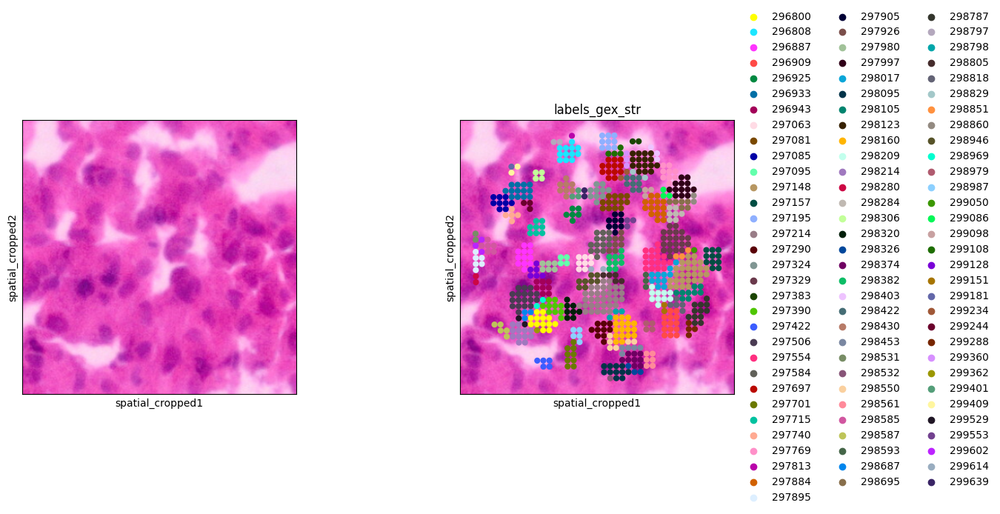

anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


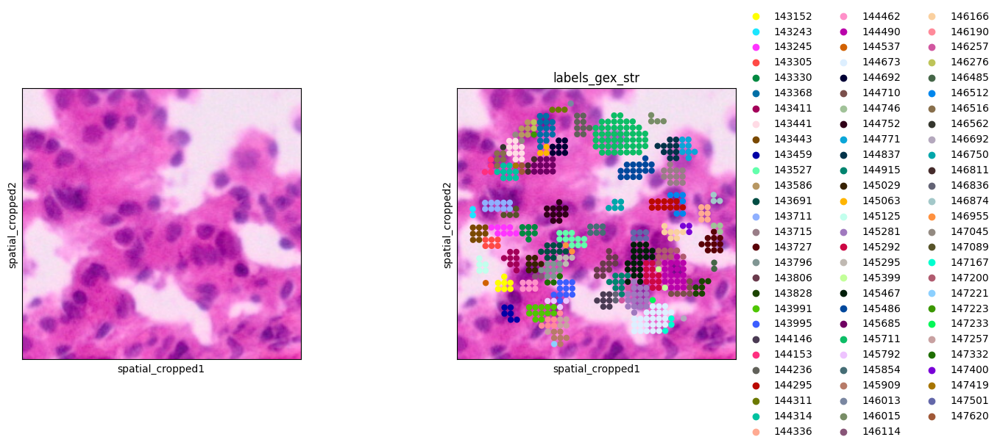

anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


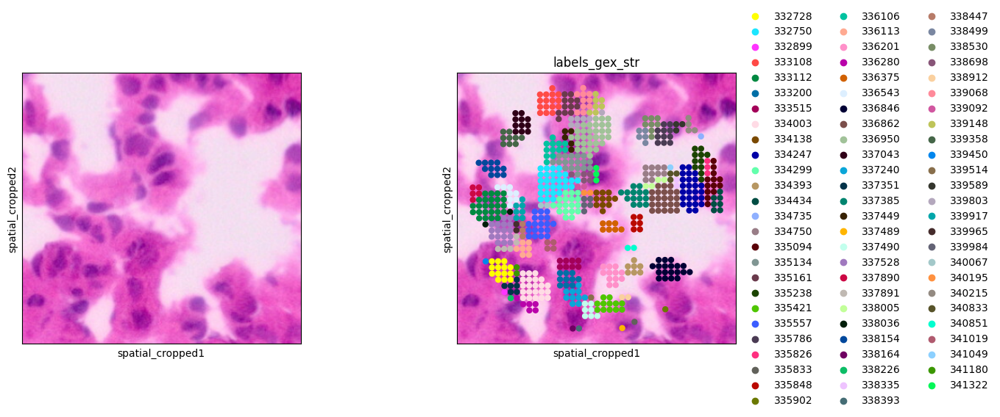

anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


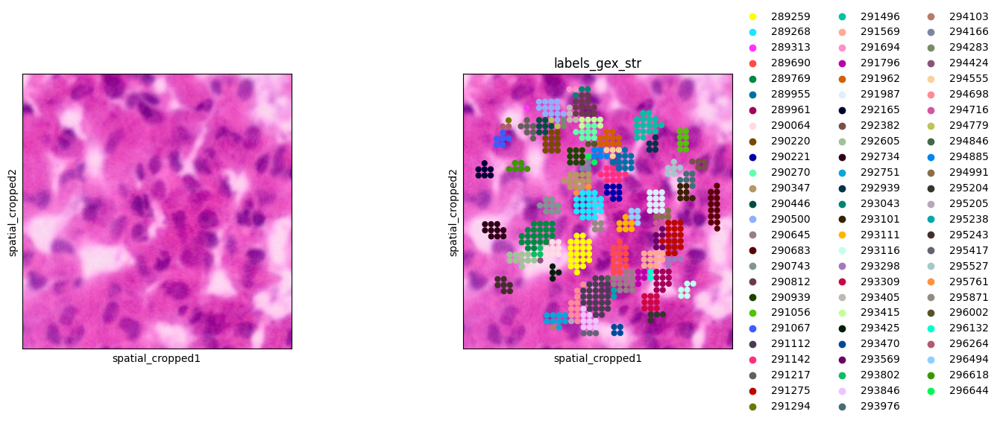

In [28]:
spots = [tuple(row) for row in adata_bin2cell[adata_bin2cell.obs["labels_gex_str"] != "0"].obsm["spatial"][np.random.choice(adata_bin2cell[adata_bin2cell.obs["labels_gex_str"] != "0"].shape[0], 4, replace=False)]]
for spot in spots:
    sc.pl.spatial(spatial_subset(adata_bin2cell[adata_bin2cell.obs["labels_gex_str"] != "0"], ["circle"], [(spot, 150)], ["keep"]), color=[None, "labels_gex_str"], img_key=f"{mpp}_mpp", basis="spatial_cropped")

anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


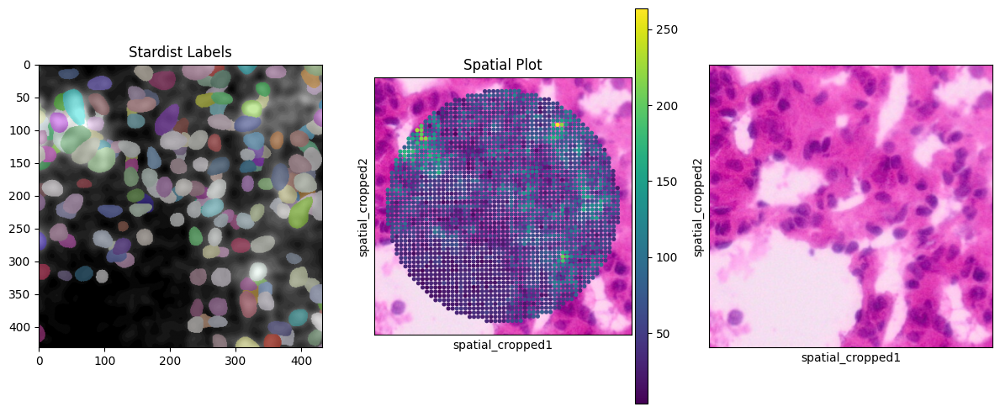

anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


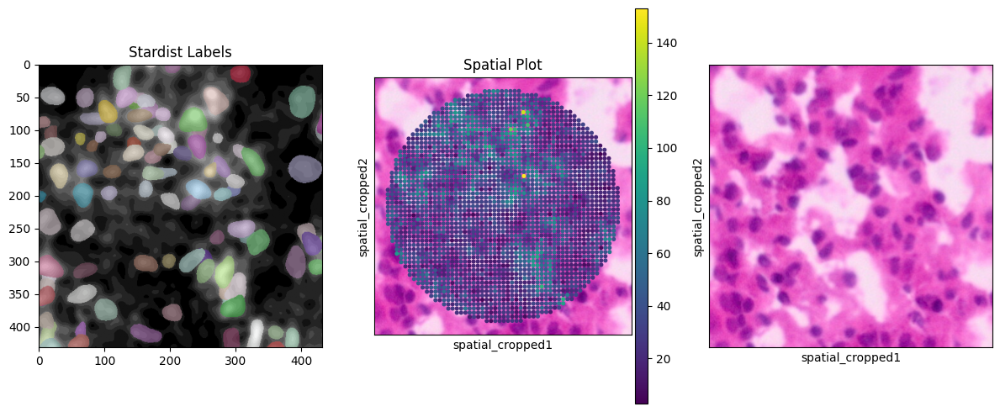

anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


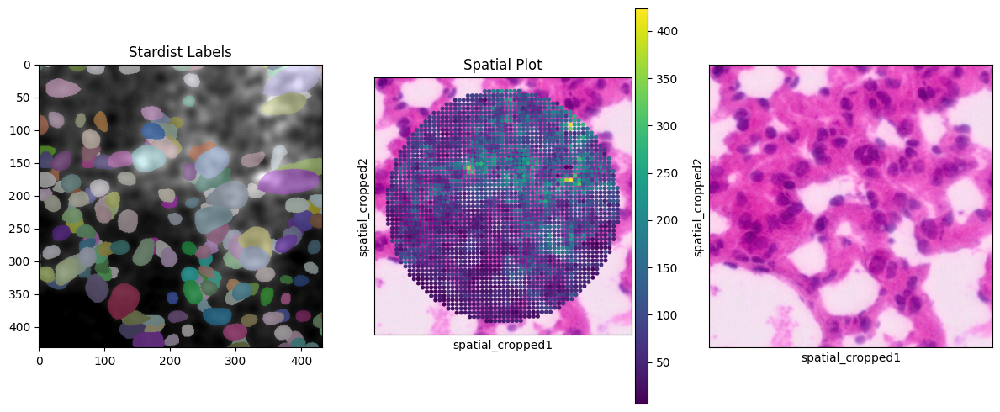

anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


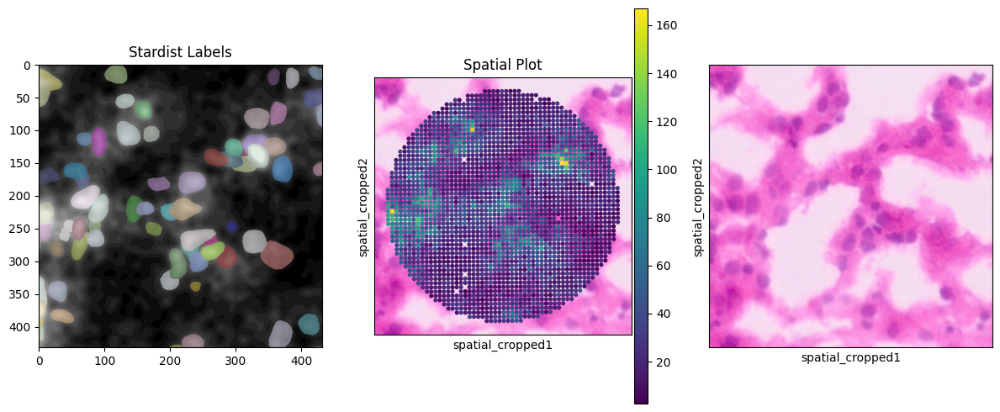

In [29]:
spots = [tuple(row) for row in adata_bin2cell[adata_bin2cell.obs["n_counts"] >= 50].obsm["spatial"][np.random.choice(adata_bin2cell[adata_bin2cell.obs["n_counts"] >= 50].obsm["spatial"].shape[0], 4, replace=False)]]
for spot in spots:
   adata_subset = spatial_subset(adata_bin2cell, ["circle"], [(spot, 200)], ["keep"])
   fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 5))
   stardist_img = b2c.view_stardist_labels(
       image_path=stardist_path / f"{mpp}_gex.tif",
       labels_npz_path=stardist_path / f"{mpp}_gex.npz", 
       crop=b2c.get_crop(adata_subset, basis="array", mpp=mpp)
   )
   ax1.imshow(stardist_img)
   ax1.set_title('Stardist Labels')
   sc.pl.spatial(adata_subset, color="n_counts_adjusted", img_key=f"{mpp}_mpp", basis="spatial_cropped", ax=ax2, show=False)
   sc.pl.spatial(adata_subset, img_key=f"{mpp}_mpp", basis="spatial_cropped", ax=ax3, show=False)
   ax2.set_title('Spatial Plot')
   plt.tight_layout()
   plt.show()

In [30]:
b2c.salvage_secondary_labels(
    adata_bin2cell, 
    primary_label="labels_he_expanded", 
    secondary_label="labels_gex", 
    labels_key="labels_joint"
)

Salvaged 62801 secondary labels


In [31]:
adata_bin2cell.obs = adata_bin2cell.obs.assign(labels_joint_str=lambda x: x.labels_joint.astype(str))
adata_bin2cell.obs

,in_tissue,array_row,array_col,n_counts,destripe_factor,n_counts_adjusted,labels_he,labels_he_str,labels_he_expanded,labels_he_expanded_str,labels_gex,labels_gex_str,labels_joint,labels_joint_source,labels_joint_str
s_002um_00658_01498-1,1,658,1498,47.0,0.708878,187.143798,0,0,275191,275191,324471,324471,275191,primary,275191
s_002um_02587_02503-1,1,2587,2503,54.0,0.077460,20.449457,0,0,0,0,0,0,0,none,0
s_002um_01674_00710-1,1,1674,710,25.0,0.391175,103.270254,131460,131460,131460,131460,0,0,131460,primary,131460
s_002um_02498_02808-1,1,2498,2808,3.0,0.077944,20.577116,0,0,0,0,74822,74822,0,none,0
s_002um_00952_00136-1,1,952,136,83.0,0.408602,107.870847,211147,211147,211147,211147,244496,244496,211147,primary,211147
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
s_002um_03248_02696-1,1,3248,2696,7.0,0.049358,13.030480,0,0,0,0,0,0,0,none,0
s_002um_00212_00415-1,1,212,415,38.0,0.473624,125.036763,0,0,0,0,355772,355772,676519,secondary,676519
s_002um_03062_00964-1,1,3062,964,17.0,0.063845,16.855117,0,0,0,0,0,0,0,none,0
s_002um_00504_01845-1,1,504,1845,27.0,0.188007,49.633858,0,0,275397,275397,0,0,275397,primary,275397


anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


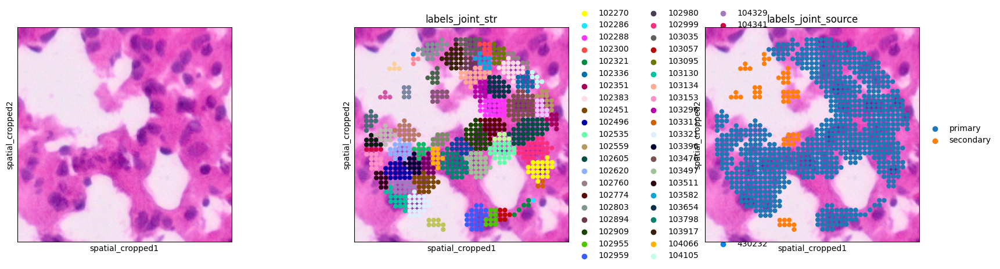

anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


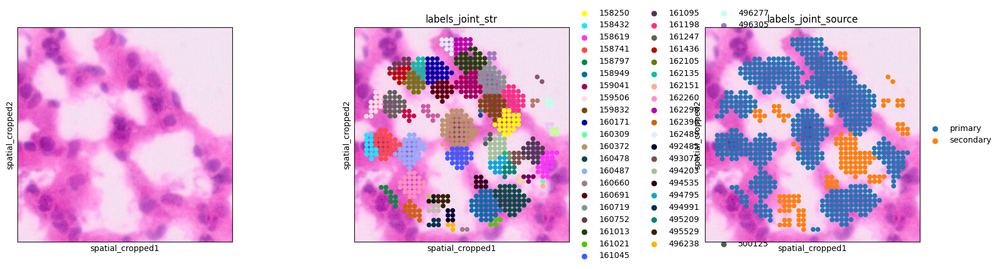

anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


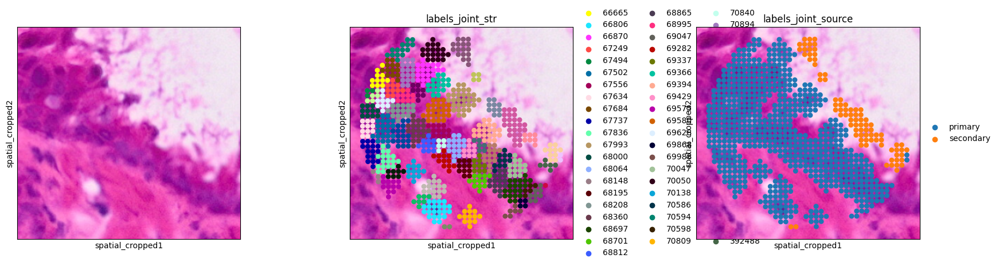

anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


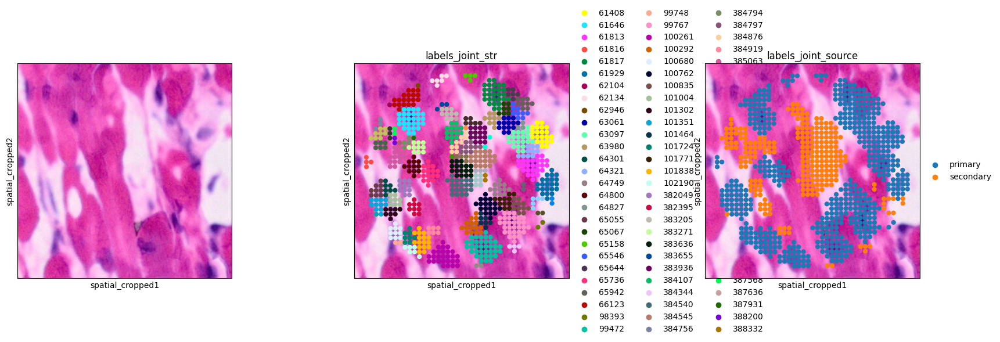

In [32]:
spots = [tuple(row) for row in adata_bin2cell[adata_bin2cell.obs["labels_joint"] != "0"].obsm["spatial"][np.random.choice(adata_bin2cell[adata_bin2cell.obs["labels_joint"] != "0"].shape[0], 4, replace=False)]]
for spot in spots:
    sc.pl.spatial(spatial_subset(adata_bin2cell[adata_bin2cell.obs["labels_joint_str"] != "0"], ["circle"], [(spot, 150)], ["keep"]), color=[None, "labels_joint_str", "labels_joint_source"], img_key=f"{mpp}_mpp", basis="spatial_cropped")

--> I dont feel like the gex sectioning adds any value in this case, so for collapsing bins to cells only the he sectioning will be used

### Collapsing bins to cells

In [84]:
adata.uns["spatial"]["Visium_HD_Mouse_Lung_Fresh_Frozen"]["images"][f"{mpp}_mpp"] = adata_bin2cell.uns["spatial"]["Visium_HD_Mouse_Lung_Fresh_Frozen"]["images"][f"{mpp}_mpp"].copy()
adata.obsm["spatial_cropped"] = adata_bin2cell.obsm["spatial_cropped"].copy()
adata.uns["spatial"]["Visium_HD_Mouse_Lung_Fresh_Frozen"]["scalefactors"] = adata_bin2cell.uns["spatial"]["Visium_HD_Mouse_Lung_Fresh_Frozen"]["scalefactors"].copy()
testdata = adata.copy()
testdata.obs = testdata.obs.join(adata_bin2cell.obs["labels_he_expanded"])
testdata

AnnData object with n_obs × n_vars = 9117867 × 17743
    obs: 'in_tissue', 'array_row', 'array_col', 'n_counts', 'labels_he_expanded'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial', 'spatial_cropped'

In [94]:
"""
Combining bin2cell results with adata object
"""
adata.uns["spatial"] = adata_bin2cell.uns["spatial"].copy()
adata.obsm["spatial_cropped"] = adata_bin2cell.obsm["spatial_cropped"].copy()
adata.obs = adata.obs.join(adata_bin2cell.obs["labels_he_expanded"])
adata

AnnData object with n_obs × n_vars = 9117867 × 17743
    obs: 'in_tissue', 'array_row', 'array_col', 'n_counts', 'labels_he_expanded'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial', 'spatial_cropped'

In [96]:
"""
Creating new adata object from collapsing annotated bins to cells
"""
adata_final = b2c.bin_to_cell(adata.copy(), labels_key="labels_he_expanded", spatial_keys=["spatial", "spatial_cropped"])
adata_final

AnnData object with n_obs × n_vars = 313497 × 17743
    obs: 'bin_count', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial', 'spatial_cropped'

anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


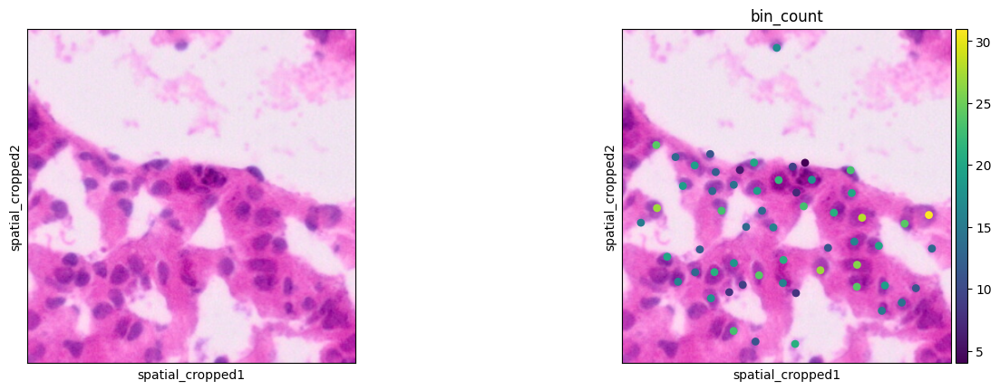

anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


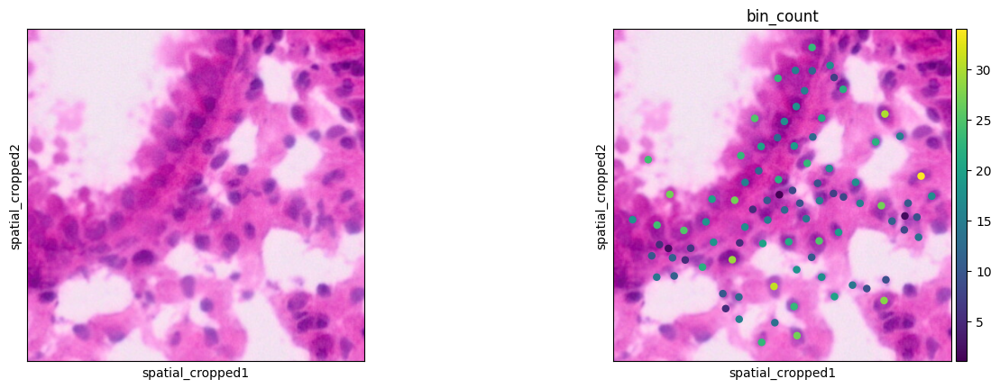

anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


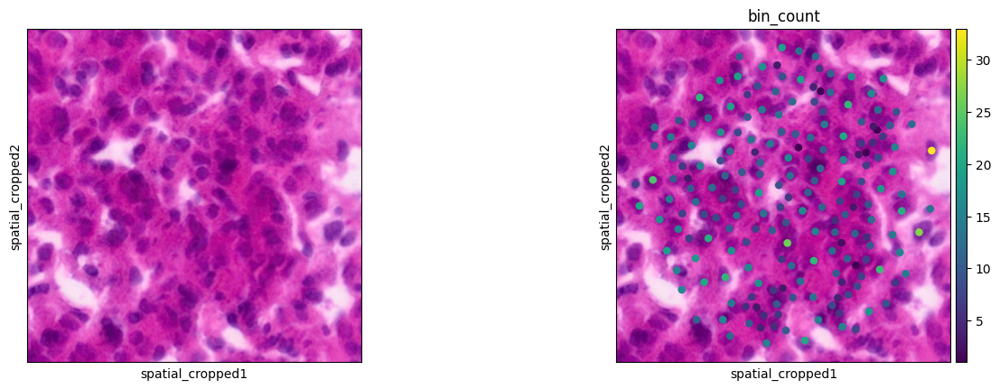

anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1145): Trying to modify attribute `.var` of view, initializing view as actual.


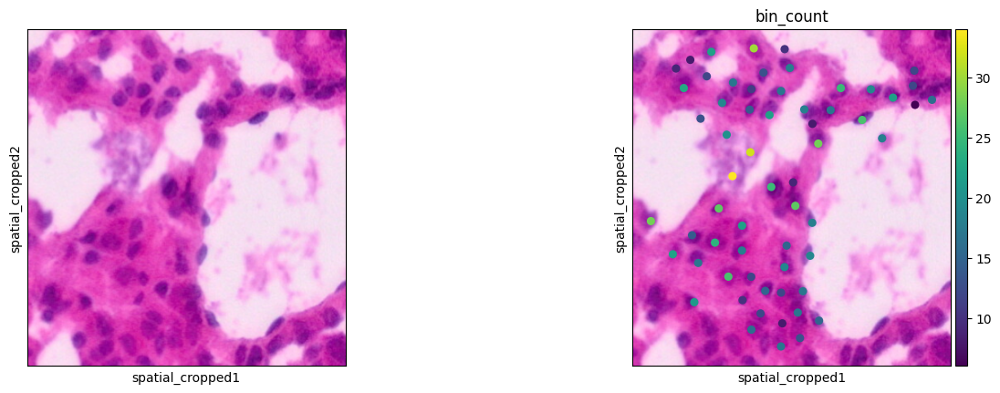

In [97]:
spots = [tuple(row) for row in adata_final.obsm["spatial"][np.random.choice(adata_final.shape[0], 4, replace=False)]]
for spot in spots:
    sc.pl.spatial(spatial_subset(adata_final, ["circle"], [(spot, 200)], ["keep"]), color=[None, "bin_count"], img_key=f"{mpp}_mpp", basis="spatial_cropped", spot_size=10)

## Saving Result

In [100]:
adata_final.write(data_folder_path / "processed" / "preprocessing" / f"{notebook_execution_time}_VisiumHD_mouse_lung_bin2cell.h5ad")

In [101]:
test = sc.read_h5ad(data_folder_path / "processed" / "preprocessing" / f"{notebook_execution_time}_VisiumHD_mouse_lung_bin2cell.h5ad")
test

AnnData object with n_obs × n_vars = 313497 × 17743
    obs: 'bin_count', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial', 'spatial_cropped'